In [ ]:
#import torch
#from torchvision import transforms
#from torch.utils.data import DataLoader
#import numpy as np
#import matplotlib.pyplot as plt
#from PIL import Image
from lime import lime_image
from skimage.segmentation import mark_boundaries

In [ ]:
import torch
import torch.nn as nn
#import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
#import pandas as pd
#import sklearn
#from sklearn.model_selection import train_test_split
#from torch.utils.data import WeightedRandomSampler
from PIL import Image
#from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix
import torchvision.models as models
#from tqdm import tqdm
import matplotlib.image as mpimg
import os

# LIME interpretability

In [152]:
def save_to_list(path):
    output_root = path
    X = []
    y = []
    l=[]
        
    label_to_index = {
        'AVM': 0,
        'Normal': 1,
        'Ulcer': 2
    }
    print(label_to_index)
    for root, _, files in os.walk(output_root):
        for file in files:
            if file.endswith(".bmp"): 
                input_path = os.path.join(root, file)

                base, ext = os.path.splitext(file)
                new_filename = f"{base}{ext}"
                image = cv2.imread(input_path)

                X.append(image)
                y.append(label_to_index[new_filename.split("_")[0]])
                l.append(new_filename)
    return X, y, l


In [ ]:
# https://discuss.pytorch.org/t/balanced-sampling-between-classes-with-torchvision-dataloader/2703/2
class ImageDataset(Dataset):
    def __init__(self, images, labels, transform=None):
        self.images = images
        self.labels = labels
        self.transform = transform 
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        image = Image.fromarray(self.images[idx])  
        label = torch.tensor(self.labels[idx], dtype=torch.long) 

        if self.transform:
            image = self.transform(image)
            
        
        return image, label

In [134]:
class ResNet50Transfer(nn.Module):
    def __init__(self, num_classes=3):
        super(ResNet50Transfer, self).__init__()
        self.base_model = models.resnet50(pretrained=True)

        # Freeze all layers (optional: you can unfreeze later for fine-tuning)
        for param in self.base_model.parameters():
            param.requires_grad = False
        
        for name, param in self.base_model.named_parameters():
            if "layer4" in name or "layer3" in name:  # Unfreeze only final block
                param.requires_grad = True

        in_features = self.base_model.fc.in_features  # Usually 2048
        self.base_model.fc = nn.Sequential(
            nn.Linear(in_features, 512),
            nn.ReLU(),
            nn.Dropout(0.4),
            nn.Linear(512, num_classes) 
        )

    def forward(self, x):
        return self.base_model(x)


In [135]:
def batch_predict(images):
    model.eval()
    transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ]) 
    device= torch.device('cpu')
    transformed = []
    for img in images:
        if isinstance(img, np.ndarray):
            img = (img * 255).astype(np.uint8)  # Przywróć do formatu obrazu
            pil_img = Image.fromarray(img)
            img_t = transform(pil_img)
            transformed.append(img_t)
    batch = torch.stack(transformed).to(device)
    with torch.no_grad():
        logits = model(batch)
        probs = torch.nn.functional.softmax(logits, dim=1)
    return probs.cpu().numpy()

In [153]:
def interpret_image(X, y, l, path, start=1, stop=None,  step=100):
    if stop is None:
        stop = len(X)
    model = ResNet50Transfer(num_classes=3) 
    model.load_state_dict(torch.load(path, map_location=torch.device('cpu')))
    for k in range(start, stop, step):
        transform = transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ]) 
        test_dataset = ImageDataset([X[k]], [y[k]], transform=transform)
        test_loader = DataLoader(test_dataset, batch_size=1)
        
        images, labels = list(test_loader)[0]
        images1, labels1 = next(iter(test_loader))
        
        model.eval()
        with torch.no_grad():
            logits = model(images1)
            prediction = torch.argmax(logits, dim=1)
        
        print(f"Predykcja: {prediction.item()}, Labels: {labels1.item()}")
        print(l[k], y[k])
        
        if labels1.item() == 1: 
            continue  # Pomijaj obrazy z etykietą 1 (Normal)
        
        for i, image in enumerate(images):

            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            unnormalized = image.permute(1, 2, 0).numpy()
            unnormalized = unnormalized * std + mean
            unnormalized = np.clip(unnormalized, 0, 1)
            
            # LIME
            explainer = lime_image.LimeImageExplainer()
            explanation = explainer.explain_instance(
                unnormalized,
                batch_predict,
                top_labels=3,
                hide_color=0,
                num_samples=1000
            )
            temp, mask = explanation.get_image_and_mask(
                label=explanation.top_labels[0],
                positive_only=True,
                num_features=1,
                hide_rest=False
            )
            
            folder_path = "archive"
            file_name = l[k] 
            label_name = file_name.split("_")[0]  
            
            full_path = os.path.join(folder_path, label_name, file_name)
            if os.path.exists(full_path):
                original_image = mpimg.imread(full_path)
            else:
                print(f"Nie znaleziono pliku: {full_path}")
                original_image = np.zeros((224, 224, 3)) 

            fig, axes = plt.subplots(1, 2, figsize=(10, 5))

            axes[0].imshow(mark_boundaries(temp, mask))
            axes[0].set_title(f"LIME dla obrazu {i}\nKlasa {explanation.top_labels[0]}")
            axes[0].axis('off')

            axes[1].imshow(original_image)
            axes[1].set_title(f"Oryginał: {file_name}")
            axes[1].axis('off')

            plt.tight_layout()
            plt.show()


- save_to_list <- przyjmuje ścieżkę do folderu zawierającego zdjęcia do analizy
- interpret_image <- przyjmuje wczytane dane oraz ścieżkę do modelu wytrenowanego (po prawej stronie wyświetlane zdjęcie referencyjne) nie wizualizuje klasy Normal (najbardziej interesuje nas czy zaznaczone fragmenty się pokrywają, a zdjęcia Normal nie mają referencyjnych adnotacji, ale w razie potrzeby można to zmienić w funkcji)

## lime dla modelu budowanego na orginalnych zdjęciach

{'AVM': 0, 'Normal': 1, 'Ulcer': 2}


c:\Users\alapr\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\alapr\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Predykcja: 0, Labels: 0
AVM_2024-08-07-08-01-08_42215.bmp 0


100%|██████████| 1000/1000 [00:38<00:00, 26.16it/s]


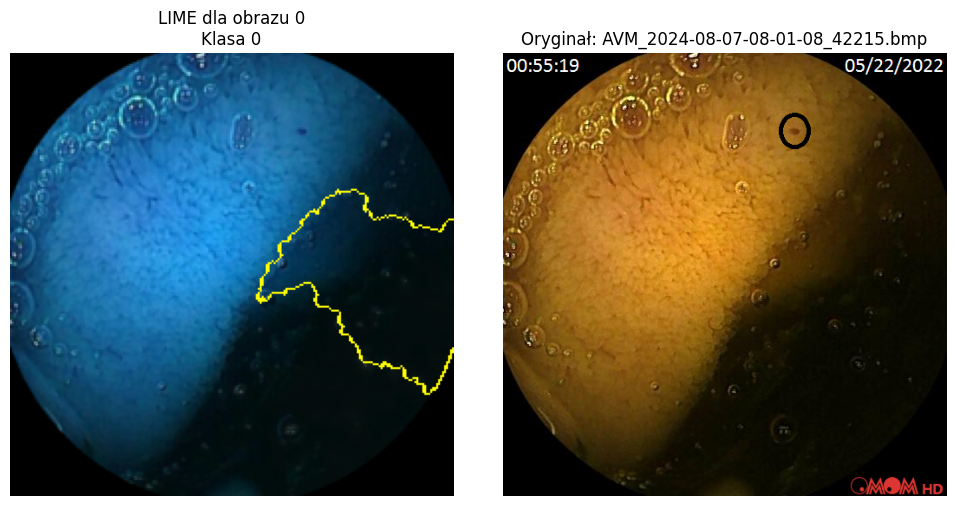

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-04-07_67115.bmp 0


100%|██████████| 1000/1000 [00:37<00:00, 26.51it/s]


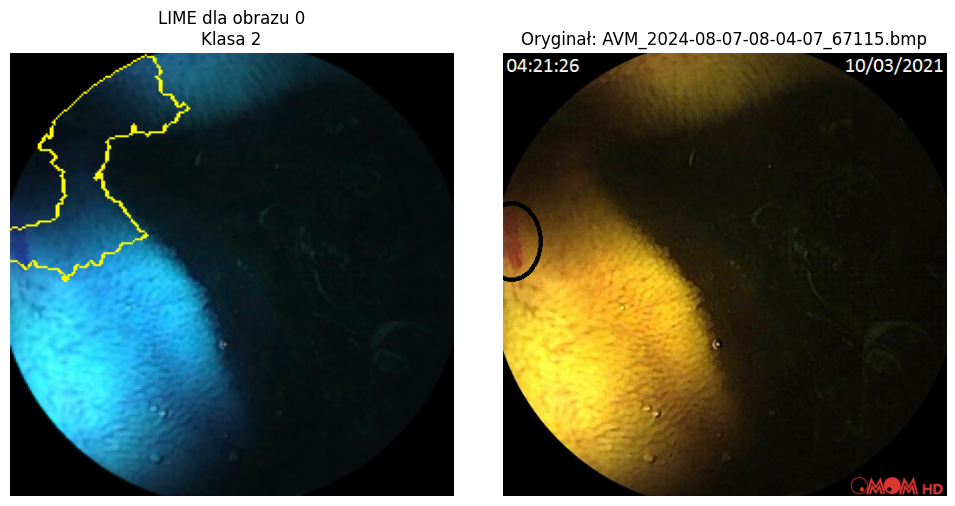

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-08-26_84730.bmp 0


100%|██████████| 1000/1000 [00:37<00:00, 26.81it/s]


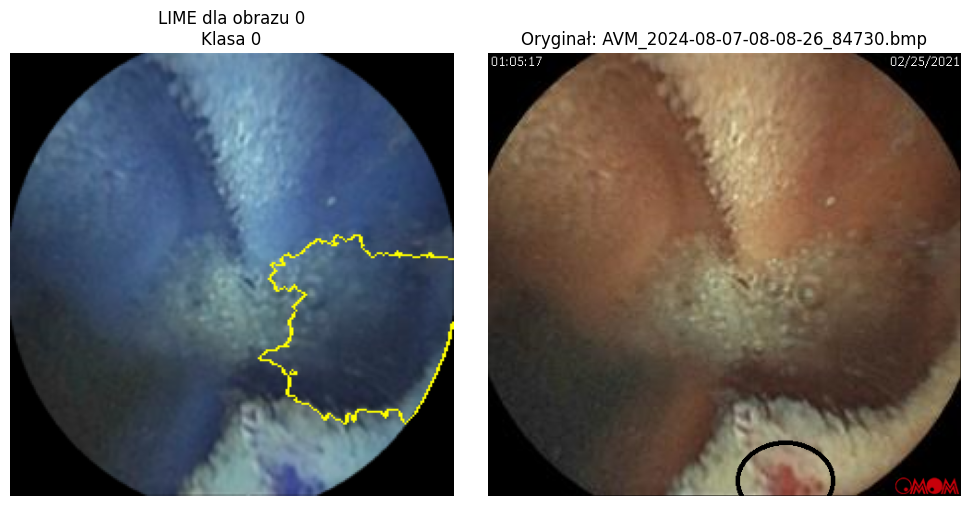

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-09-26_57847.bmp 0


100%|██████████| 1000/1000 [00:37<00:00, 26.54it/s]


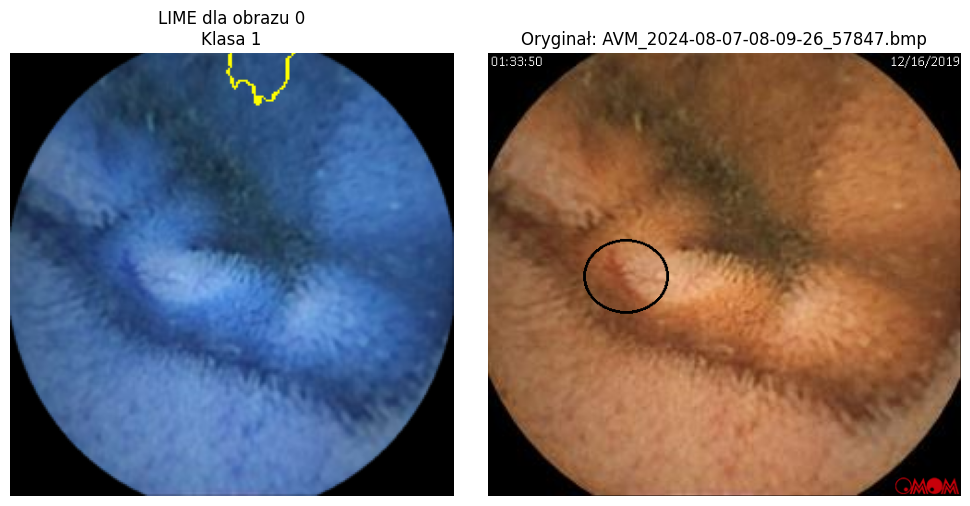

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-12-50_29519.bmp 0


100%|██████████| 1000/1000 [00:37<00:00, 26.46it/s]


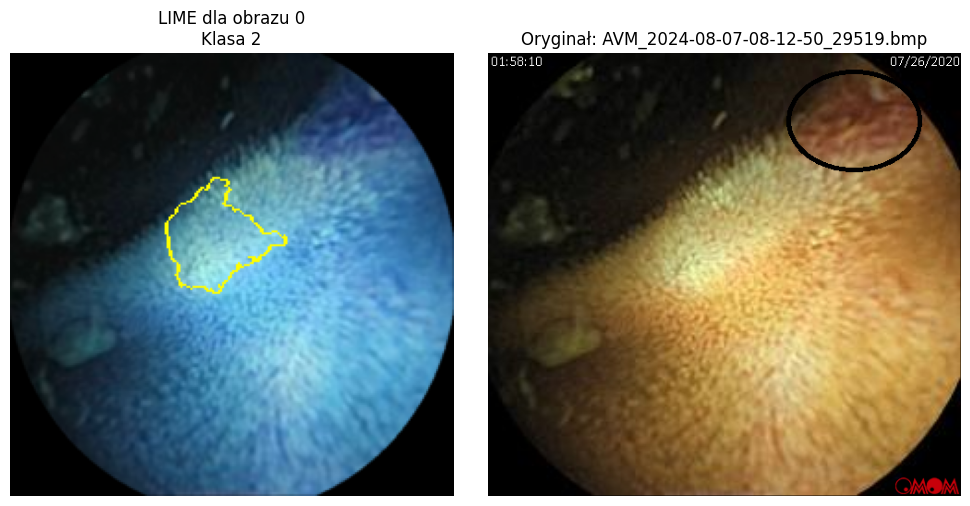

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-16-02_85929.bmp 0


100%|██████████| 1000/1000 [00:37<00:00, 26.45it/s]


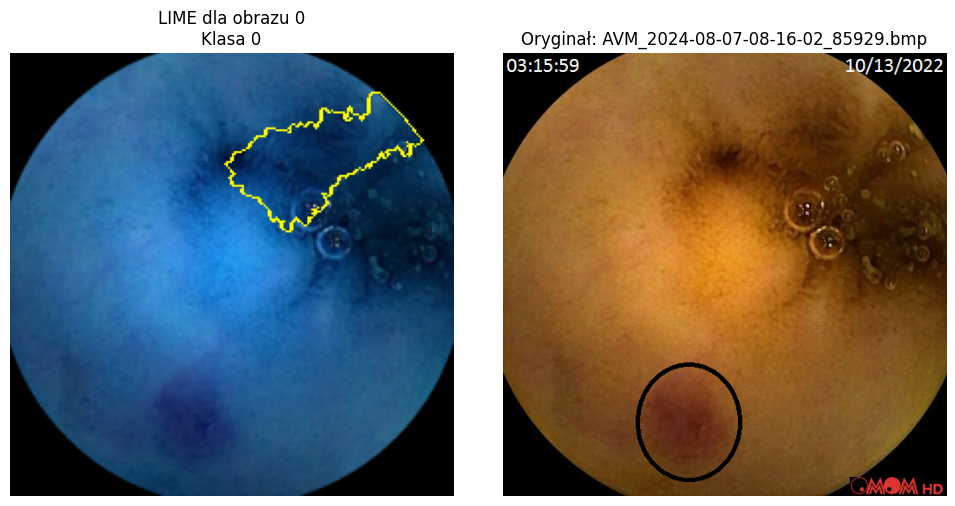

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-20-18_12404.bmp 0


100%|██████████| 1000/1000 [00:37<00:00, 26.64it/s]


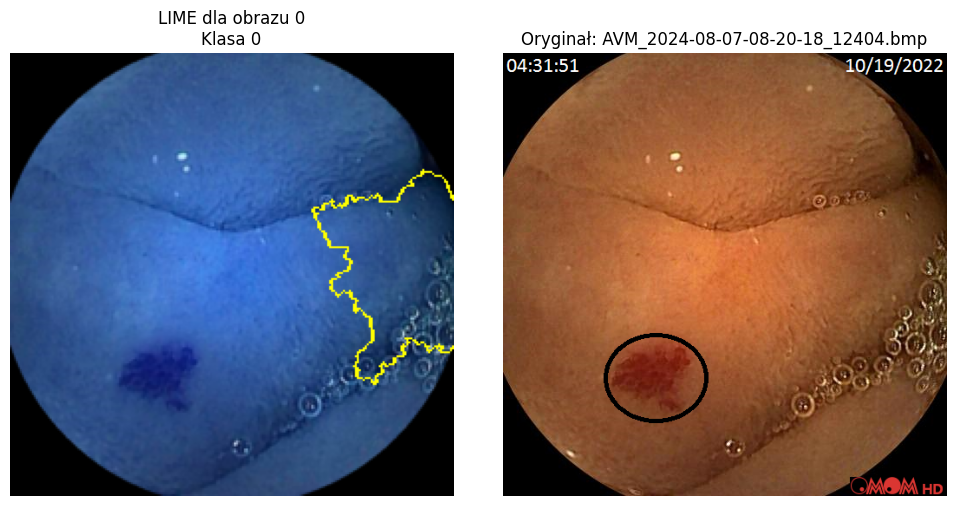

Predykcja: 1, Labels: 1
Normal_2024-08-07-07-47-35_23347.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-47-36_25988.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-48-56_33432.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-48-57_42091.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-49-30_20015.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-49-30_55055.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-50-54_27351.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-50-54_66709.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-51-23_46947.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-51-24_50186.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-51-57_24953.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-51-58_42140.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-53-19_16142.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-53-19_66592.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-54-25_26506.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-54-25_8601

100%|██████████| 1000/1000 [00:37<00:00, 26.65it/s]


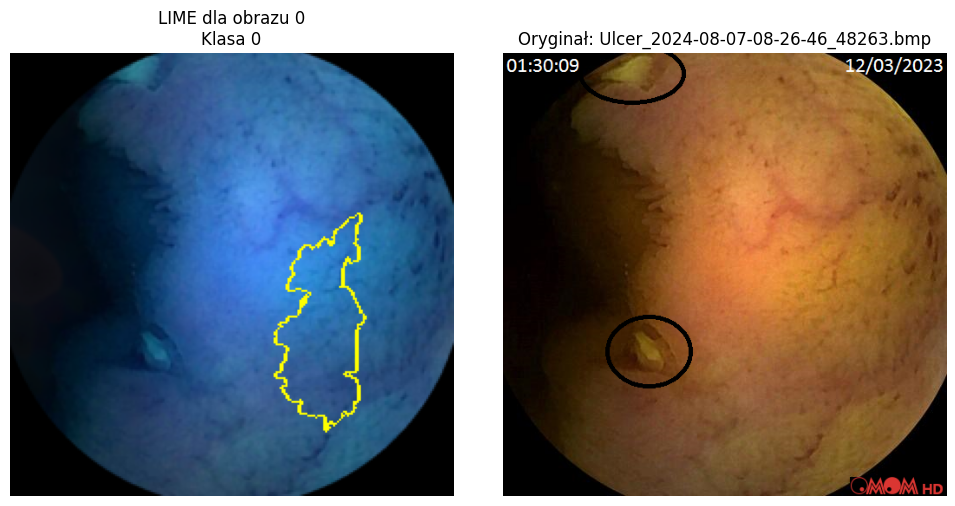

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-28-23_30157.bmp 2


100%|██████████| 1000/1000 [00:37<00:00, 26.59it/s]


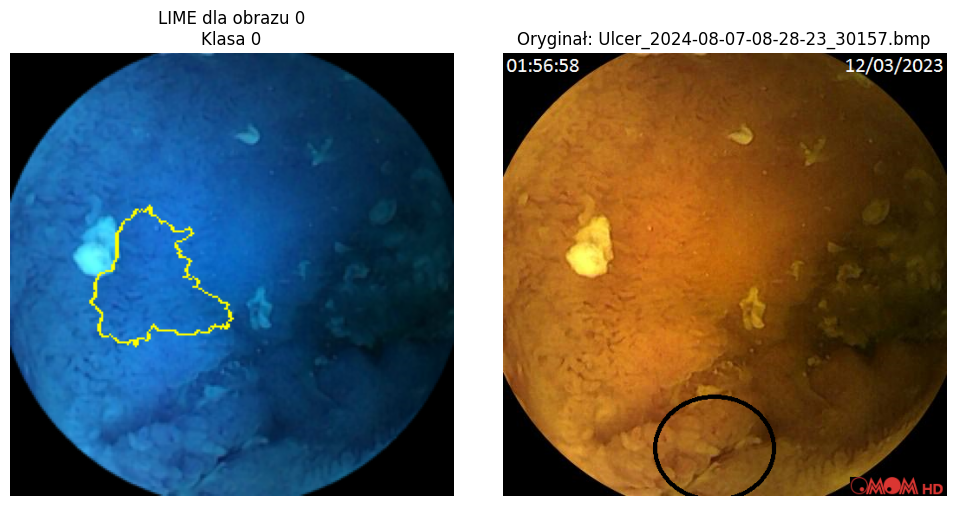

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-29-07_88524.bmp 2


100%|██████████| 1000/1000 [00:37<00:00, 26.54it/s]


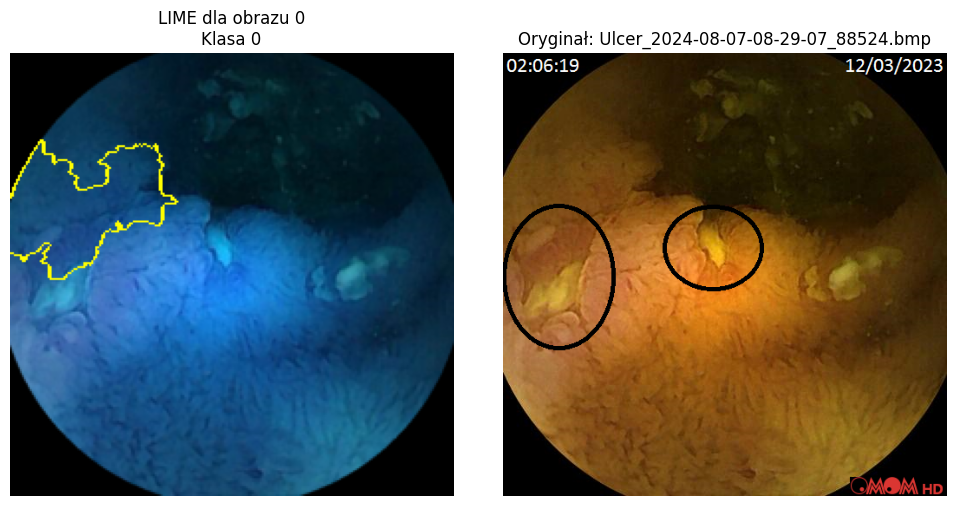

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-30-04_91673.bmp 2


100%|██████████| 1000/1000 [00:37<00:00, 26.62it/s]


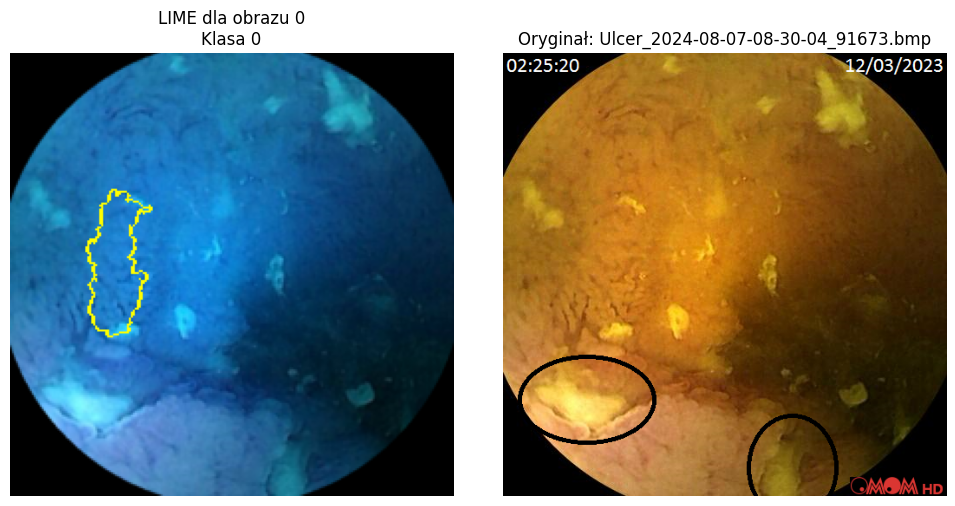

In [161]:
X,y, l = save_to_list("output")
interpret_image(X, y, l,"model_output_simple.pth")

## lime dla modeli budowanych na zdjęciach uciętych do bardziej znaczących obszarów

### Czy usunięcie części duplikatów za pomocą klasteryzacji zapewni uczenie się modelu na istotnych miejscach czy dalej będzie uczył się na pamięć szumu?

- output <- orginały bez adnotacji
- model_cropped_photos_radius_50 <- model wytrenowany na zdjęciach z folderu (cropped_out_50) zawierający fragment ze zmianą chorobową lub losowy fragment w przypadku klasy 'Normal'

{'AVM': 0, 'Normal': 1, 'Ulcer': 2}


c:\Users\alapr\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\alapr\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Predykcja: 0, Labels: 0
AVM_2024-08-07-08-01-08_42215.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.39it/s]


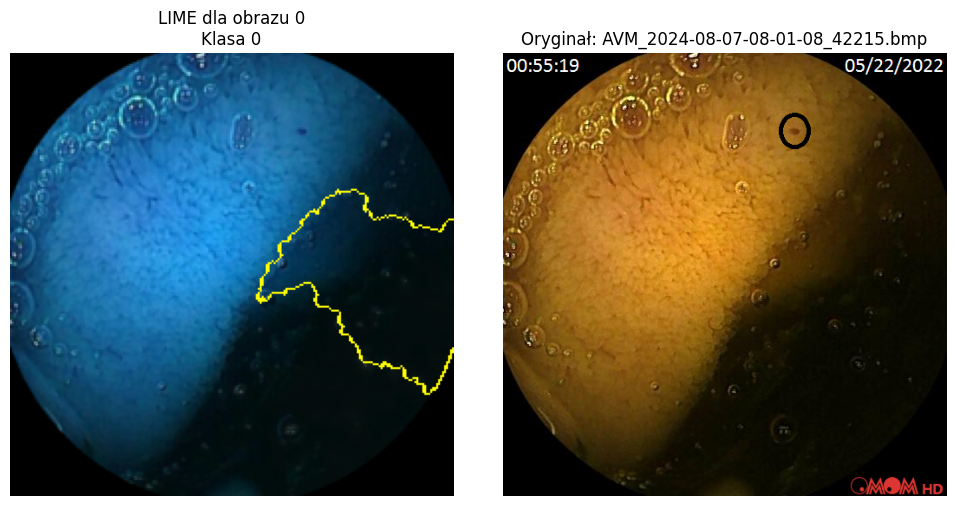

Predykcja: 2, Labels: 0
AVM_2024-08-07-08-04-07_67115.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.41it/s]


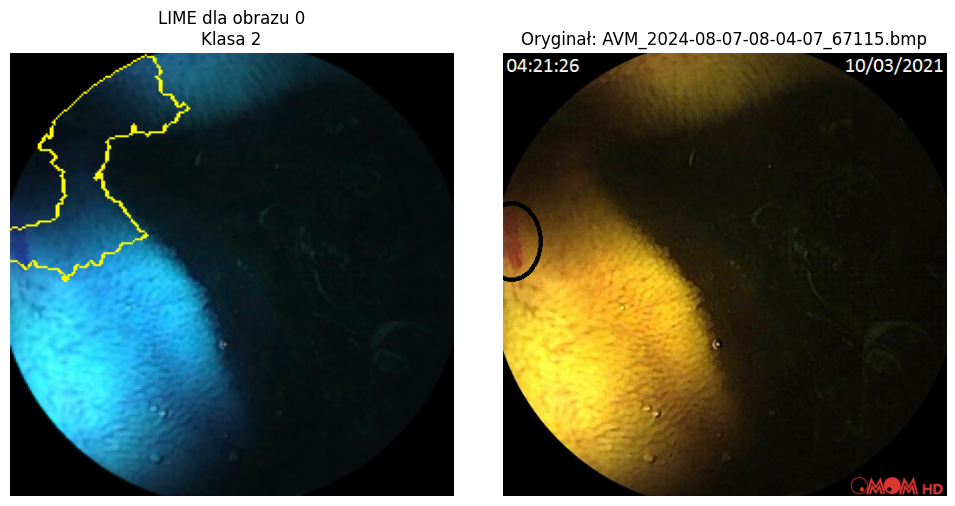

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-08-26_84730.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.35it/s]


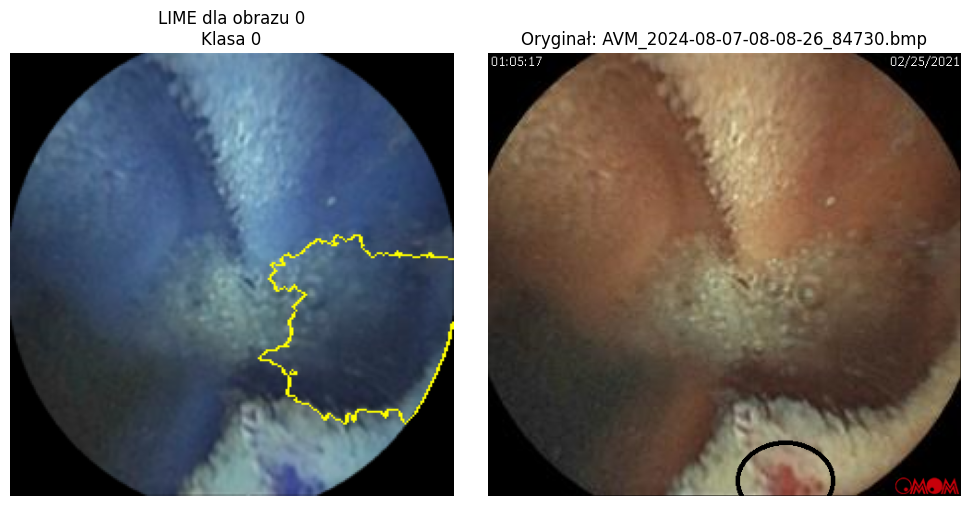

Predykcja: 1, Labels: 0
AVM_2024-08-07-08-09-26_57847.bmp 0


100%|██████████| 1000/1000 [00:45<00:00, 22.04it/s]


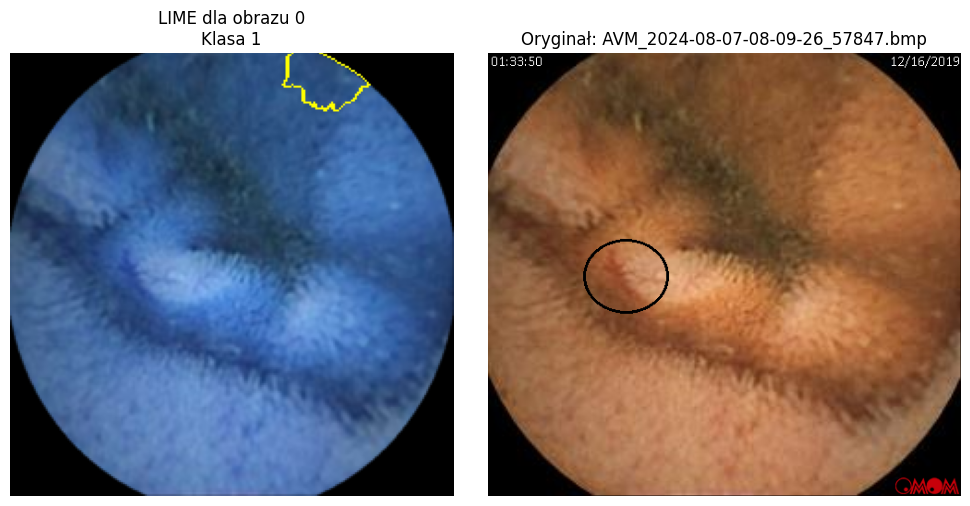

Predykcja: 2, Labels: 0
AVM_2024-08-07-08-12-50_29519.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.29it/s]


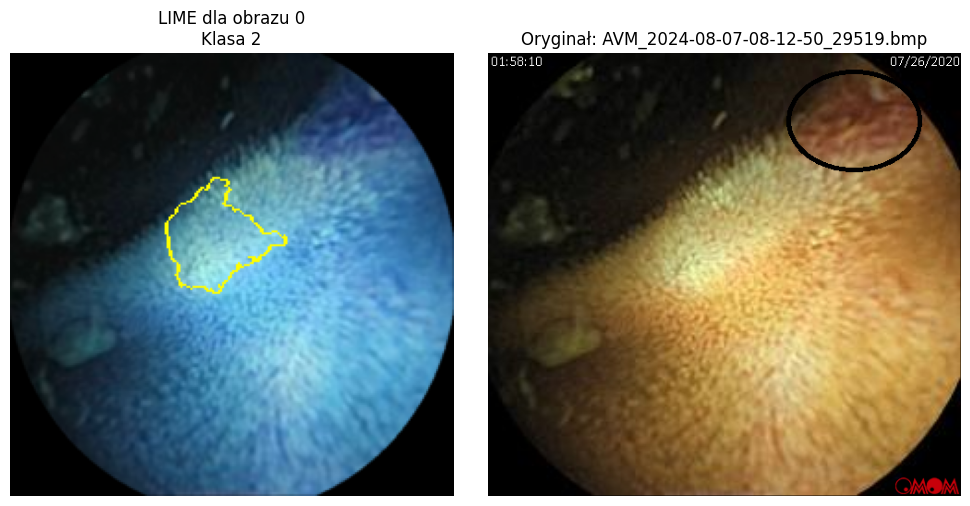

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-16-02_85929.bmp 0


100%|██████████| 1000/1000 [00:45<00:00, 21.86it/s]


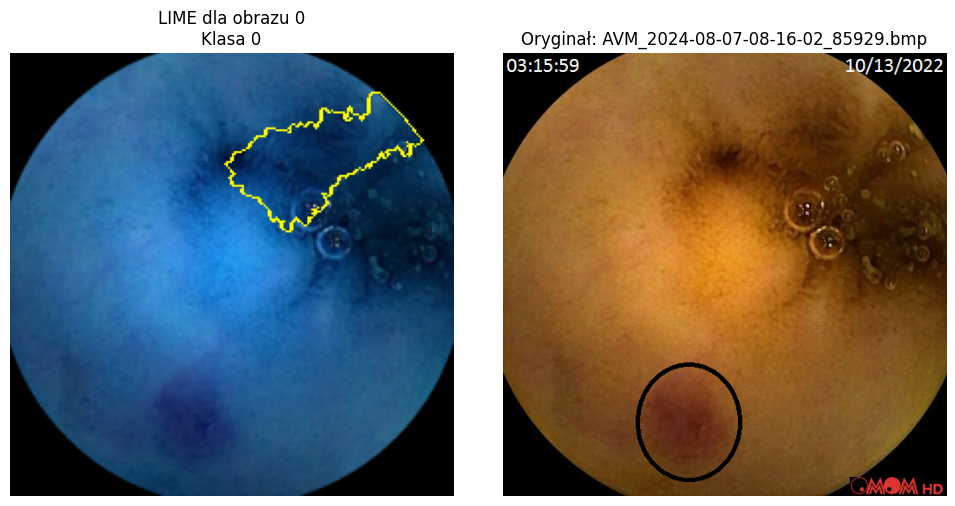

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-20-18_12404.bmp 0


100%|██████████| 1000/1000 [00:45<00:00, 22.21it/s]


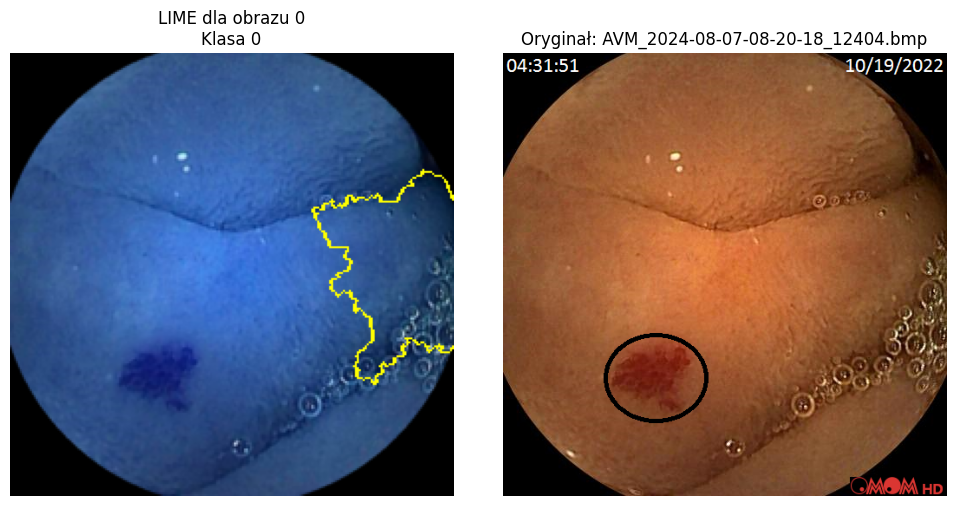

Predykcja: 0, Labels: 1
Normal_2024-08-07-07-47-35_23347.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-47-36_25988.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-48-56_33432.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-48-57_42091.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-49-30_20015.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-49-30_55055.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-50-54_27351.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-50-54_66709.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-51-23_46947.bmp 1
Predykcja: 2, Labels: 1
Normal_2024-08-07-07-51-24_50186.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-51-57_24953.bmp 1
Predykcja: 2, Labels: 1
Normal_2024-08-07-07-51-58_42140.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-53-19_16142.bmp 1
Predykcja: 2, Labels: 1
Normal_2024-08-07-07-53-19_66592.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-54-25_26506.bmp 1
Predykcja: 0, Labels: 1
Normal_2024-08-07-07-54-25_8601

100%|██████████| 1000/1000 [00:45<00:00, 22.10it/s]


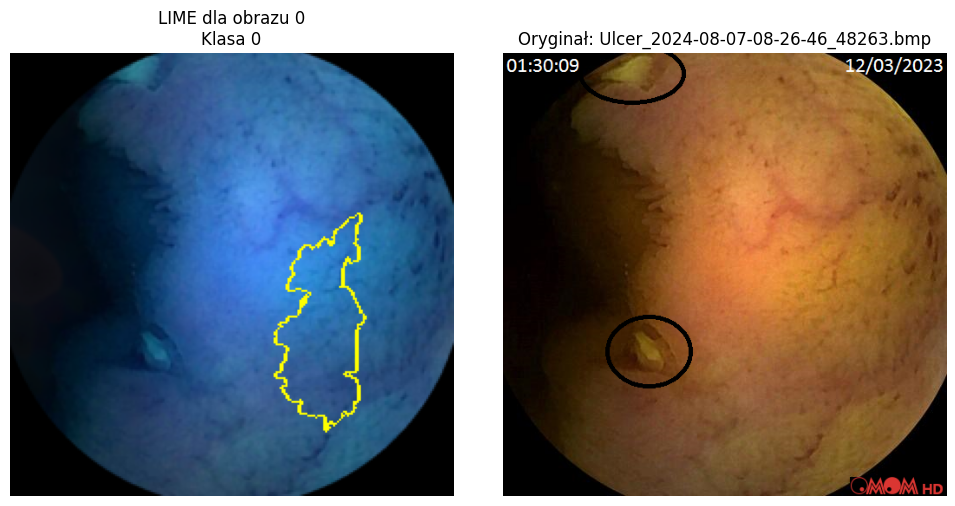

Predykcja: 0, Labels: 2
Ulcer_2024-08-07-08-28-23_30157.bmp 2


100%|██████████| 1000/1000 [00:45<00:00, 21.77it/s]


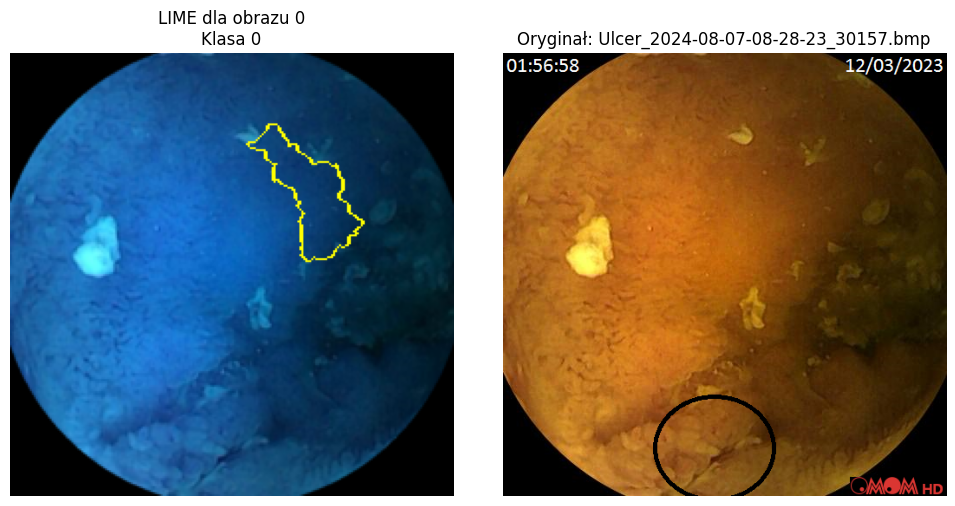

Predykcja: 0, Labels: 2
Ulcer_2024-08-07-08-29-07_88524.bmp 2


100%|██████████| 1000/1000 [00:44<00:00, 22.31it/s]


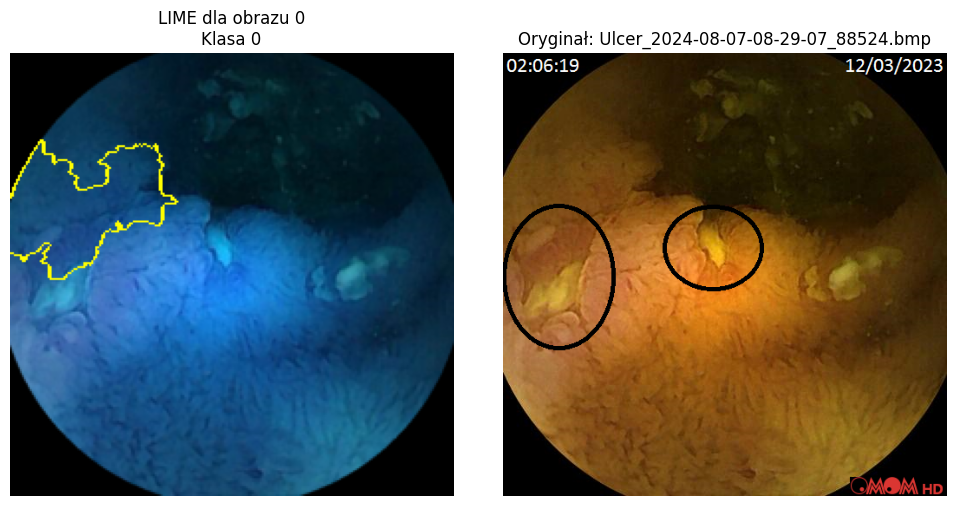

Predykcja: 0, Labels: 2
Ulcer_2024-08-07-08-30-04_91673.bmp 2


100%|██████████| 1000/1000 [00:45<00:00, 21.89it/s]


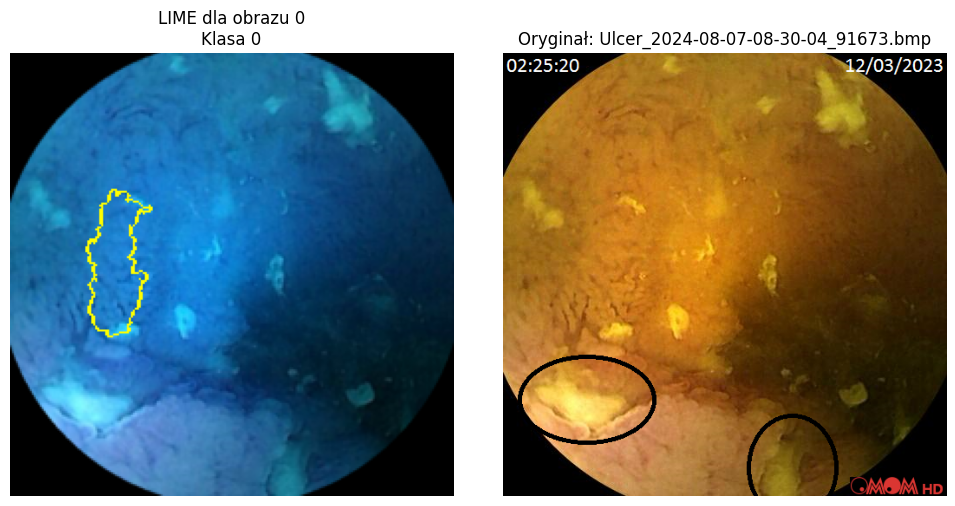

In [159]:
X,y, l = save_to_list("output")
interpret_image(X, y, l,"model_cropped_photos_radius_50.pth")


Wyniki z tego wywołania:
- model nie ma 100 % skuteczności więc zdarzają się błędne klasyfikacje
- nawet w przypadku trafnej klasyfikacji miejsce, które decyduje nie pokrywa się ze zmianą chorobową
- może nieuzasadnione jest sprawdzanie modelu na zdjęciach zawierających większy fragment niż użyte do treningu? 

{'AVM': 0, 'Normal': 1, 'Ulcer': 2}
Predykcja: 0, Labels: 0
AVM_2024-08-07-08-01-08_42215.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.44it/s]


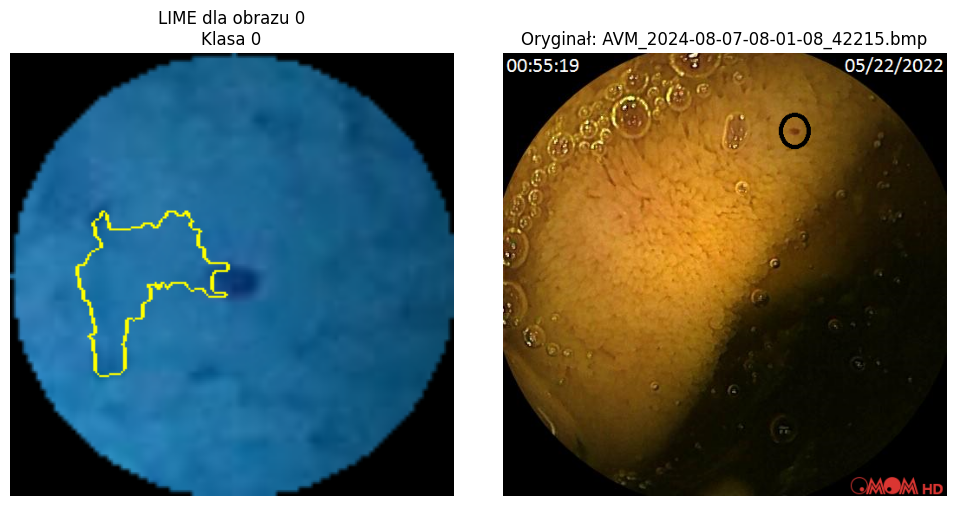

Predykcja: 2, Labels: 0
AVM_2024-08-07-08-04-07_67115.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.36it/s]


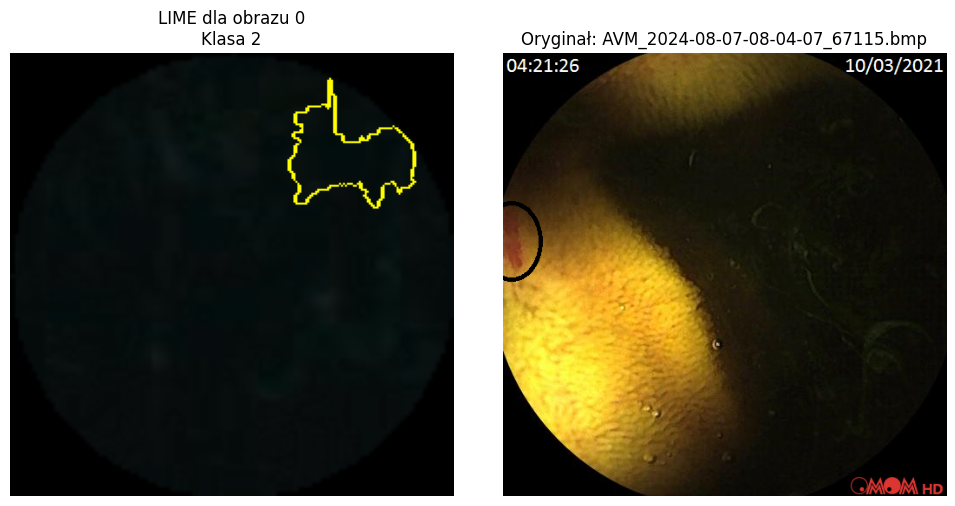

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-08-26_84730.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.62it/s]


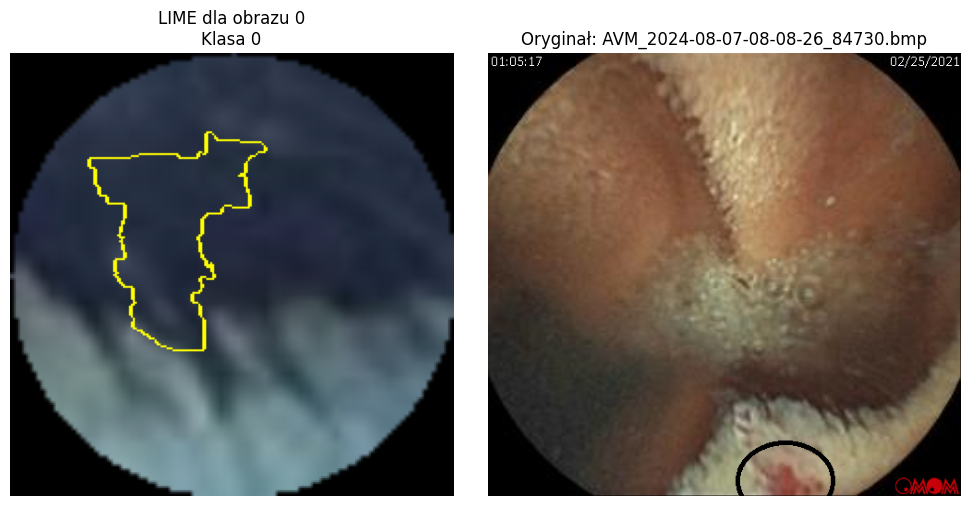

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-09-26_57847.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.57it/s]


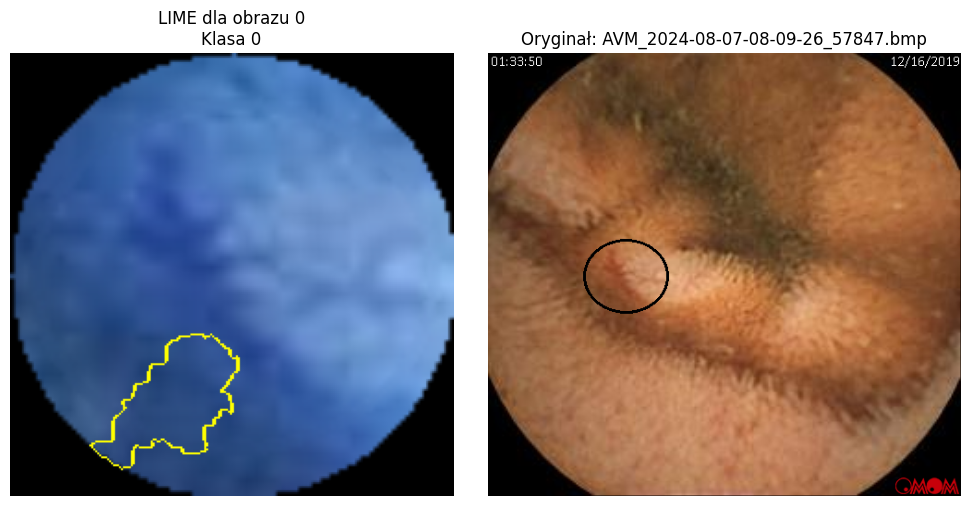

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-12-50_29519.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.45it/s]


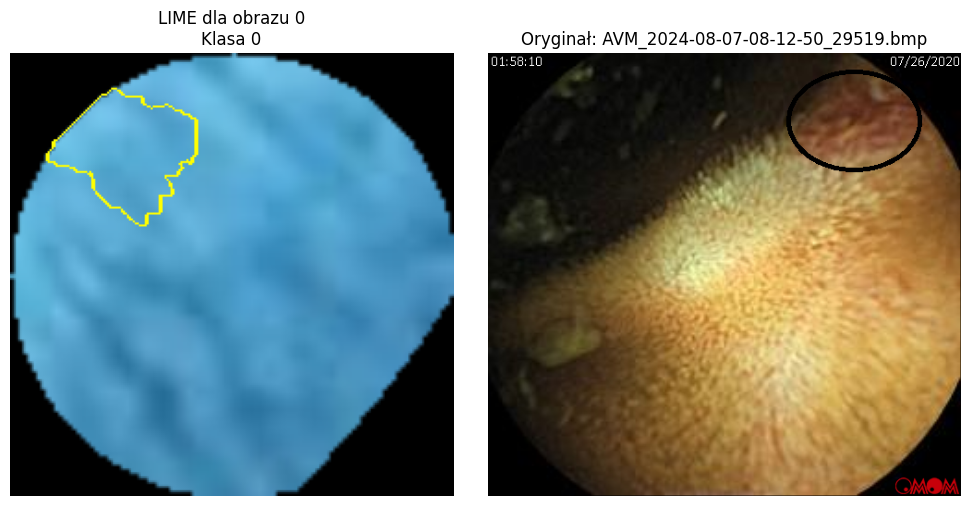

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-16-02_85929.bmp 0


100%|██████████| 1000/1000 [00:45<00:00, 22.18it/s]


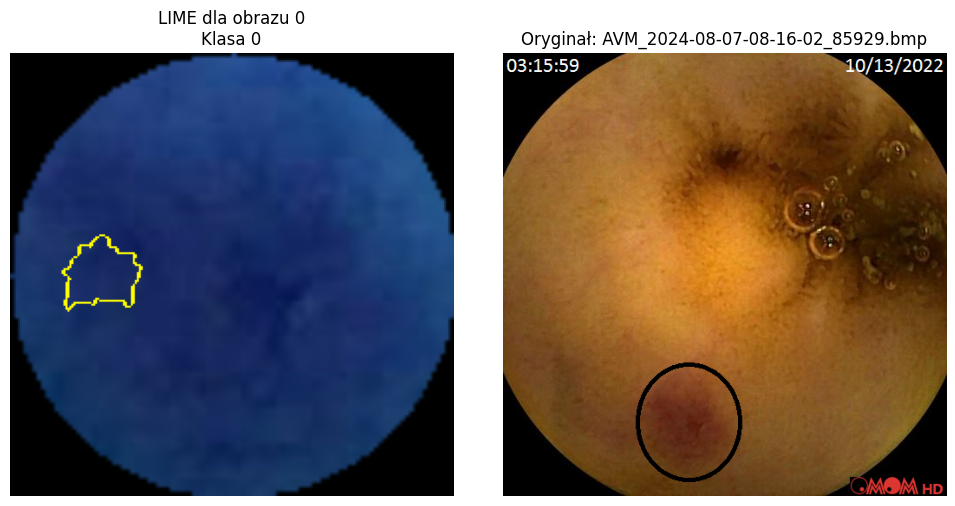

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-20-18_12404.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.38it/s]


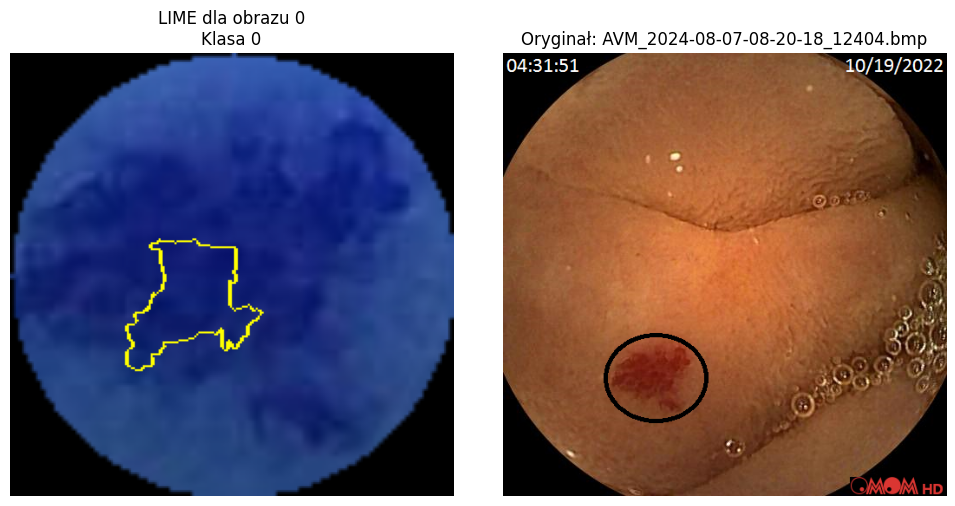

Predykcja: 1, Labels: 1
Normal_2024-08-07-07-47-35_23347.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-47-36_25988.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-48-56_33432.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-48-57_42091.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-49-30_20015.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-49-30_55055.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-50-54_27351.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-50-54_66709.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-51-23_46947.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-51-24_50186.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-51-57_24953.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-51-58_42140.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-53-19_16142.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-53-19_66592.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-54-25_26506.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-54-25_8601

100%|██████████| 1000/1000 [00:45<00:00, 22.10it/s]


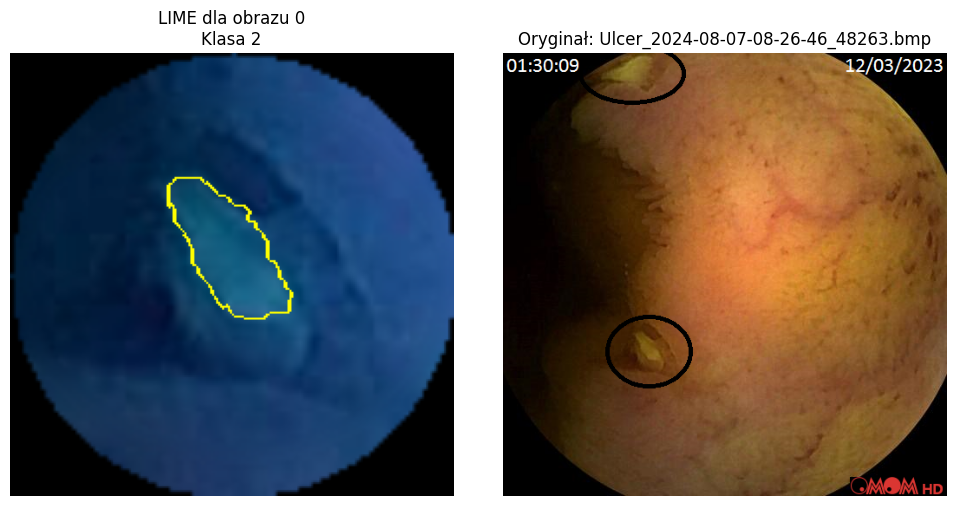

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-28-23_30157.bmp 2


100%|██████████| 1000/1000 [00:44<00:00, 22.44it/s]


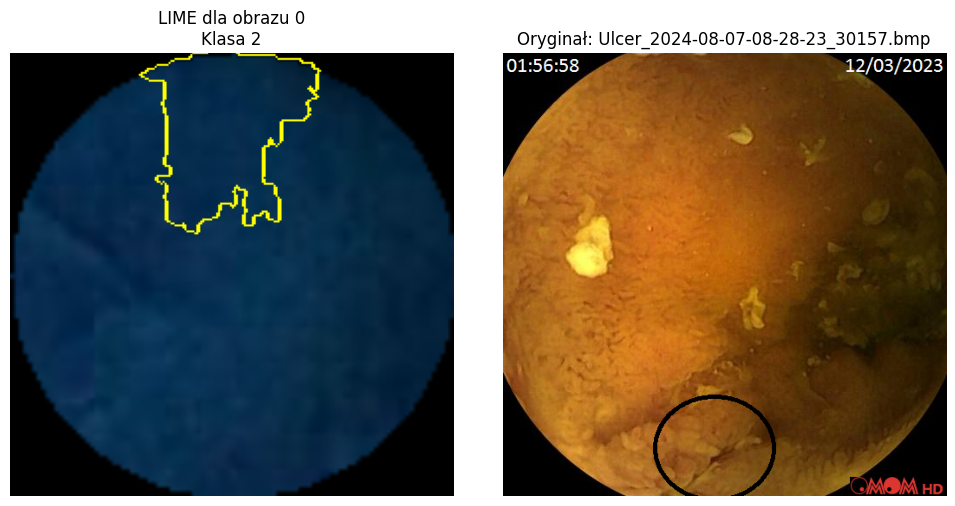

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-29-07_88524.bmp 2


100%|██████████| 1000/1000 [00:44<00:00, 22.32it/s]


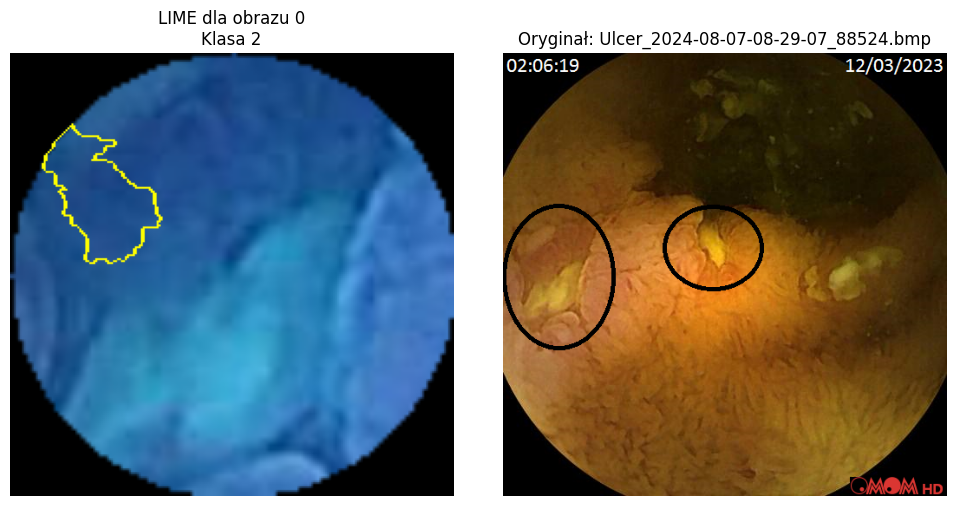

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-30-04_91673.bmp 2


100%|██████████| 1000/1000 [00:44<00:00, 22.28it/s]


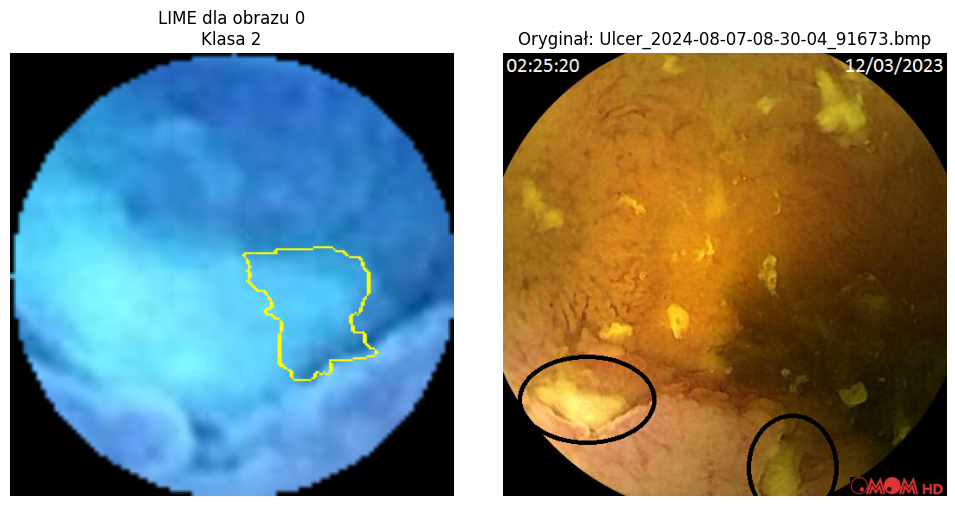

In [158]:
X,y, l = save_to_list("cropped_out_50")
interpret_image(X, y, l,"model_cropped_photos_radius_50.pth")


Wyniki z tego wywołania:
- dla dużych zmian zajmujących prawie cały obszar wyniki nie są najgorsze, ale losowy obszar też by pokrywał zmianę więc o niczym nie świadczą
- dla mniejszych zmian wydaje się, że omija te zmiany
- mniej wyraźne zmiany ciężko interpretować
- niektóre zdjęcia po przycinaniu niewyraźnie i użycie ich może być błędne

{'AVM': 0, 'Normal': 1, 'Ulcer': 2}


c:\Users\alapr\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\alapr\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Predykcja: 0, Labels: 0
AVM_2024-08-07-08-02-00_49020.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.28it/s]


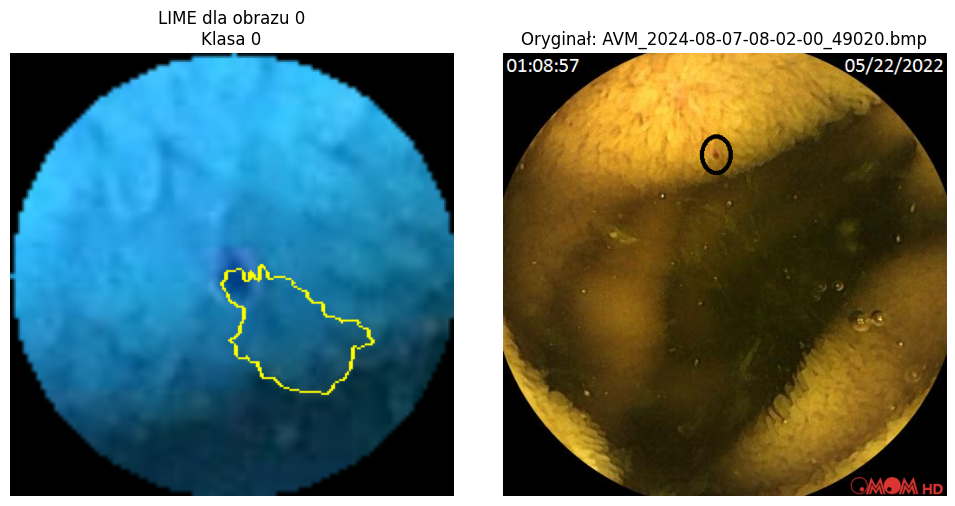

Predykcja: 1, Labels: 0
AVM_2024-08-07-08-04-07_61111.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.42it/s]


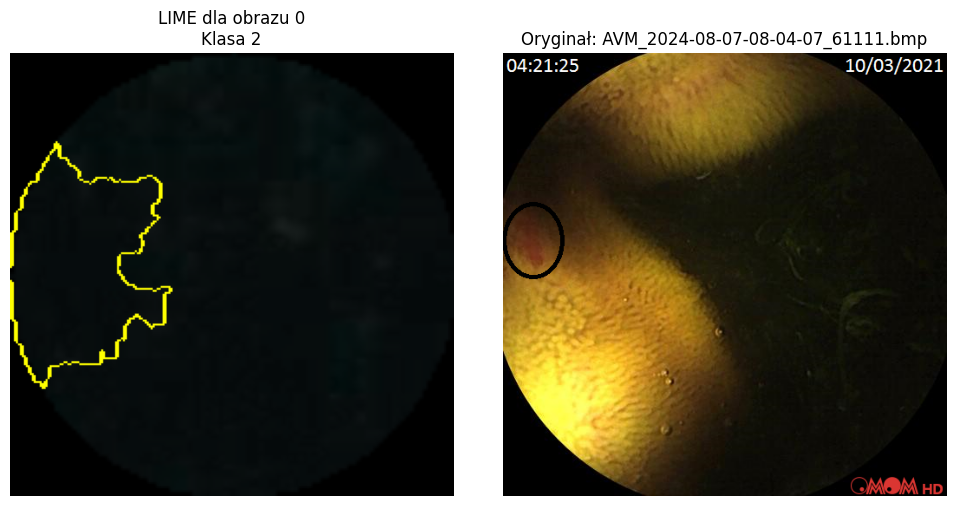

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-06-10_27610.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.40it/s]


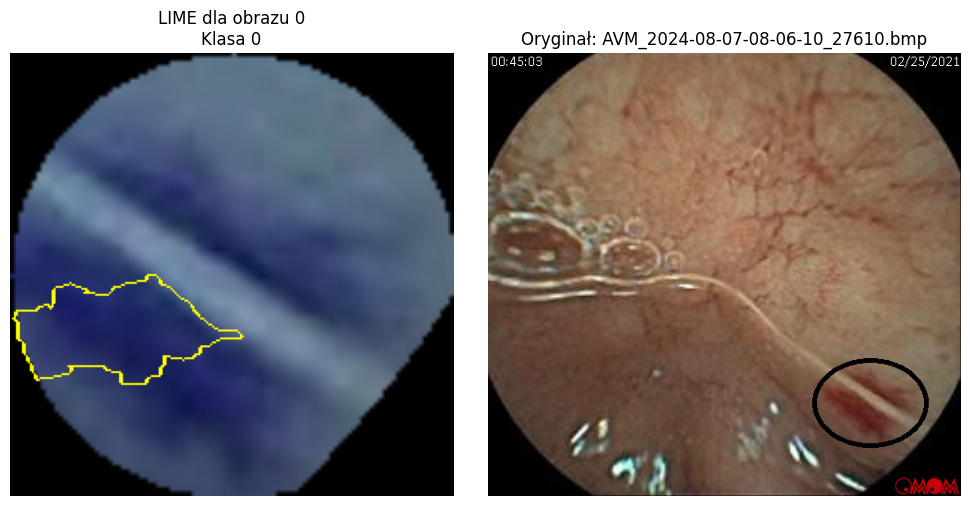

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-08-26_80238.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.30it/s]


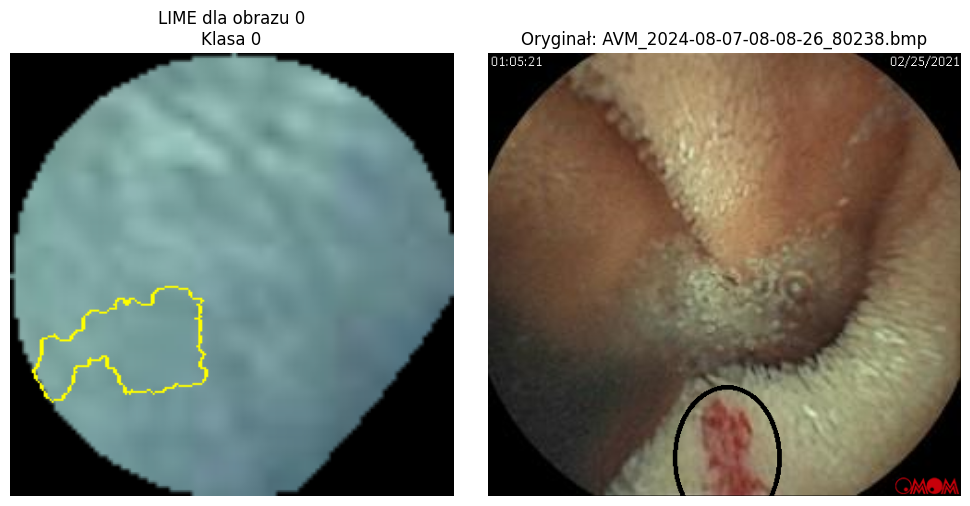

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-08-50_43533.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.52it/s]


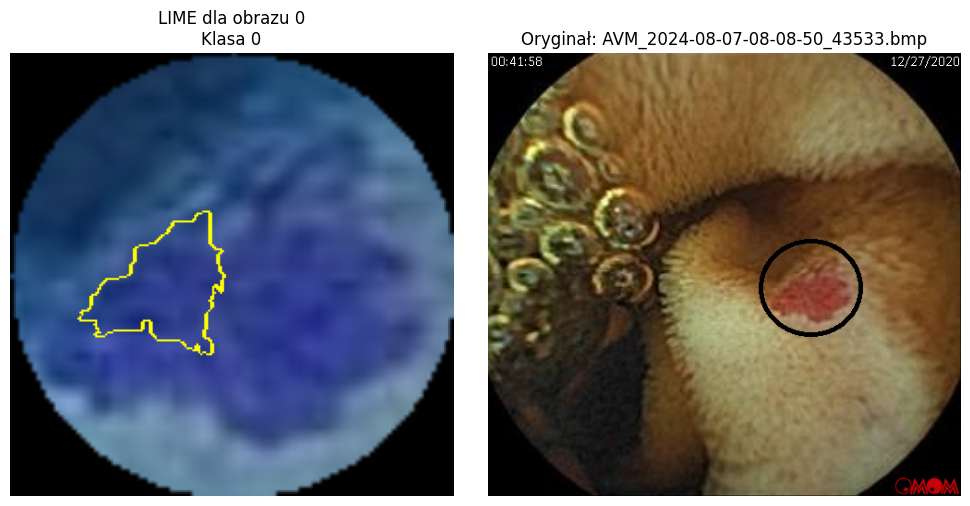

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-09-26_52224.bmp 0


100%|██████████| 1000/1000 [00:45<00:00, 22.22it/s]


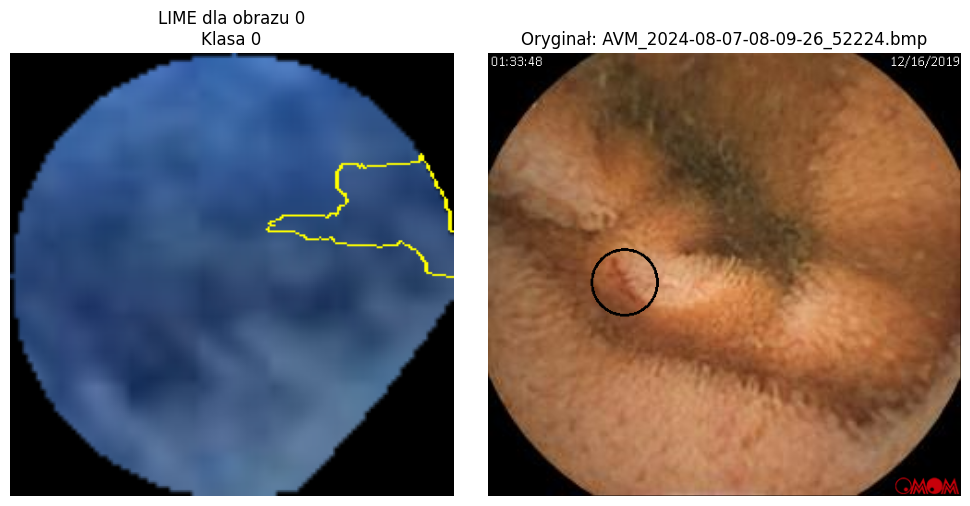

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-10-11_86626.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.23it/s]


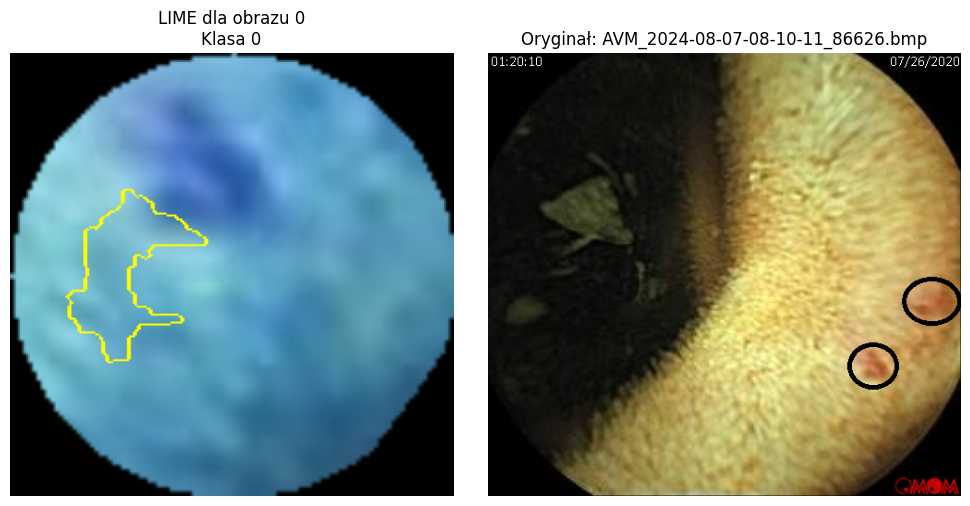

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-12-36_79476.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.48it/s]


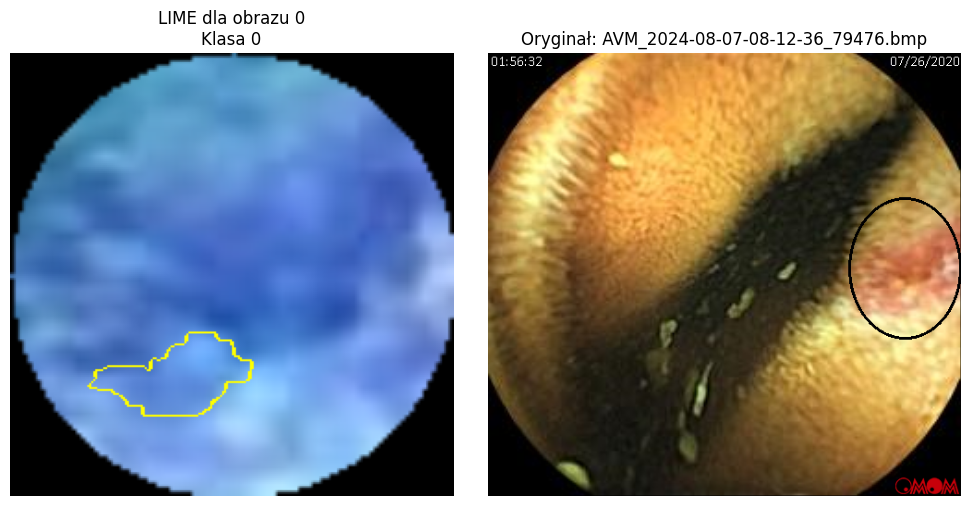

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-14-24_34041.bmp 0


100%|██████████| 1000/1000 [00:45<00:00, 21.98it/s]


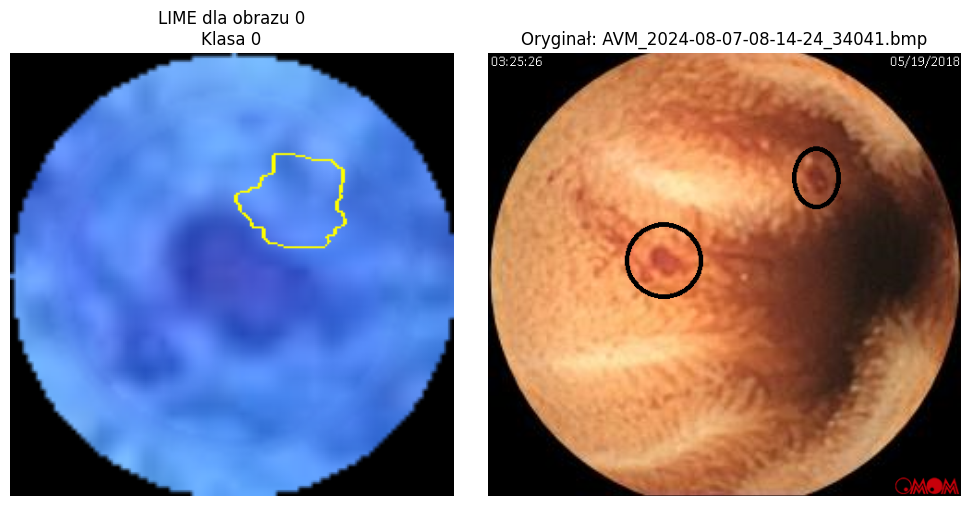

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-16-02_12319.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.42it/s]


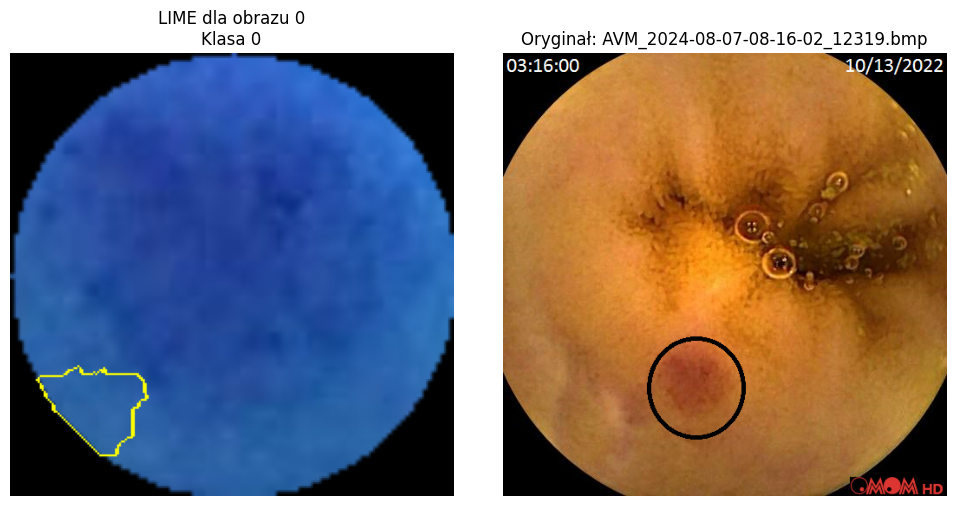

Predykcja: 1, Labels: 0
AVM_2024-08-07-08-19-06_29993.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.39it/s]


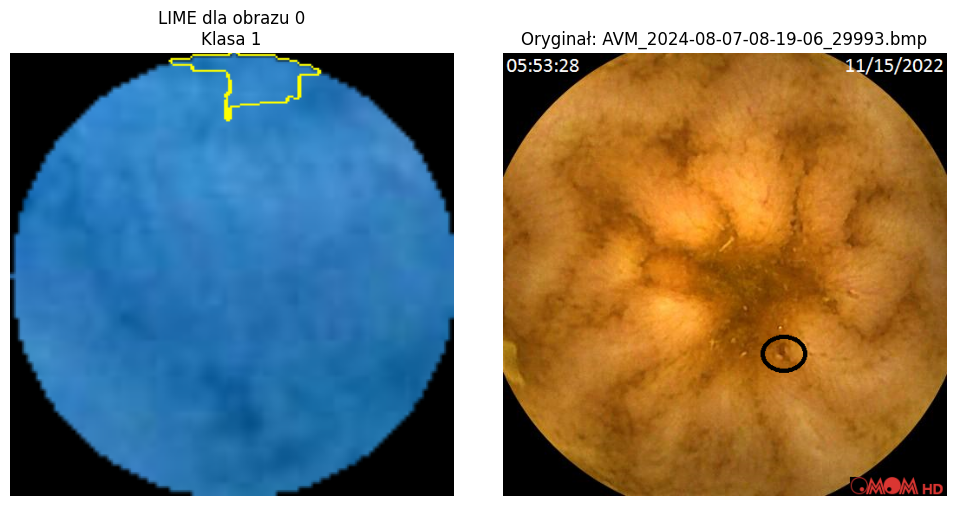

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-19-52_92947.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.46it/s]


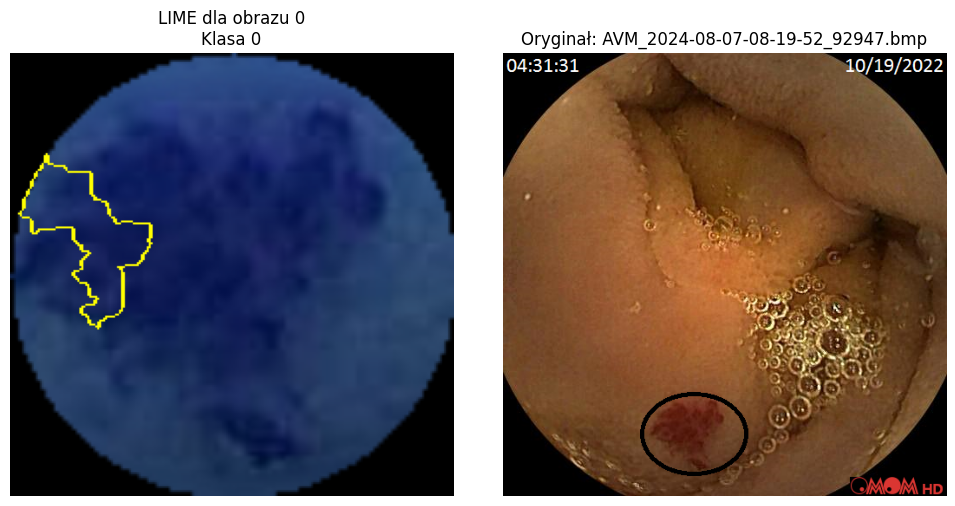

Predykcja: 0, Labels: 0
AVM_2024-08-07-08-21-16_51204.bmp 0


100%|██████████| 1000/1000 [00:44<00:00, 22.57it/s]


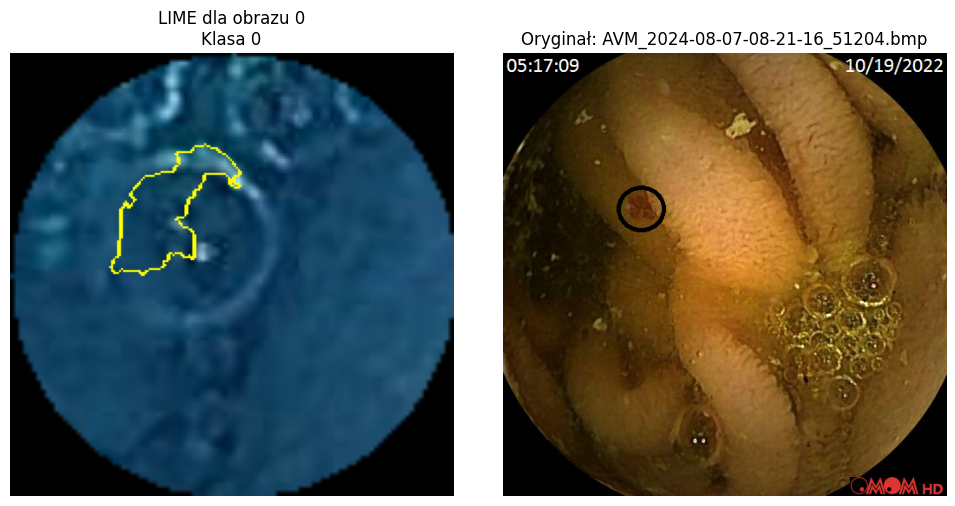

Predykcja: 1, Labels: 1
Normal_2024-08-07-07-47-35_23321.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-47-35_46535.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-47-36_25221.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-47-36_74444.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-48-56_32564.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-48-57_17078.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-48-57_41405.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-48-57_75596.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-49-30_19857.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-49-30_36525.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-49-30_53926.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-49-30_99274.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-50-54_26192.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-50-54_42428.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-50-54_66491.bmp 1
Predykcja: 1, Labels: 1
Normal_2024-08-07-07-50-55_9011

100%|██████████| 1000/1000 [00:44<00:00, 22.61it/s]


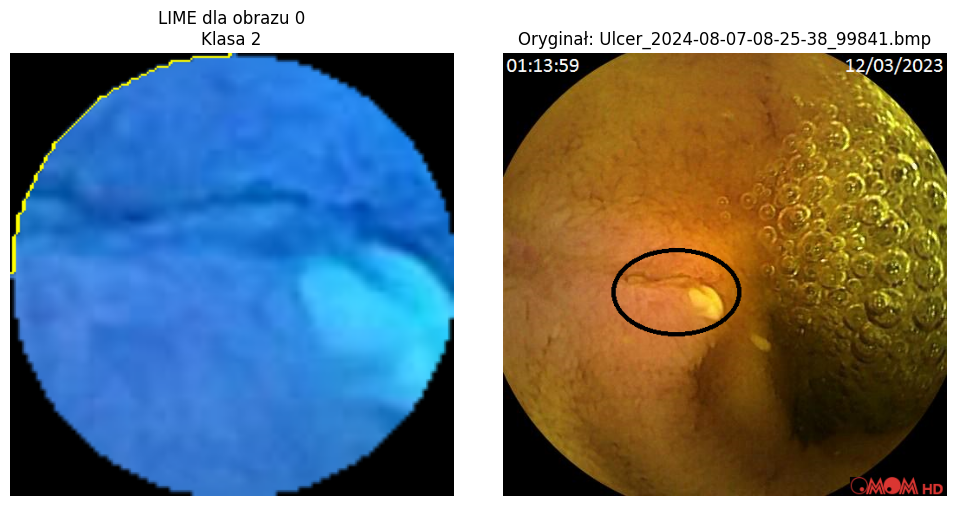

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-26-46_46013.bmp 2


100%|██████████| 1000/1000 [00:44<00:00, 22.43it/s]


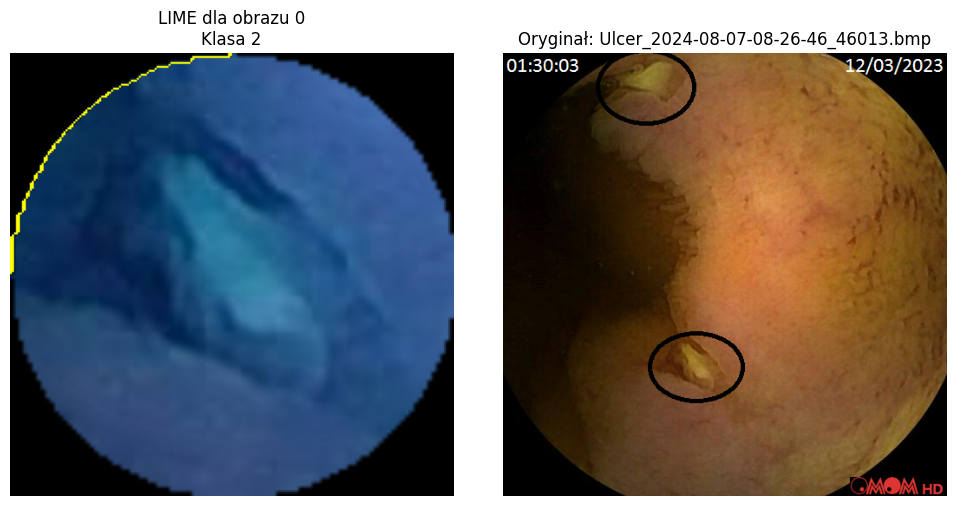

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-27-27_96319.bmp 2


100%|██████████| 1000/1000 [04:37<00:00,  3.60it/s] 


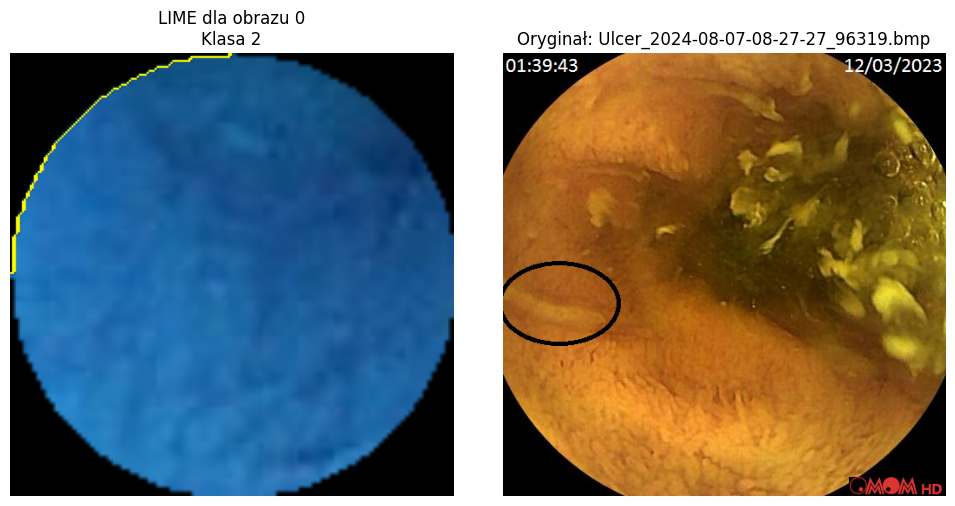

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-28-23_28396.bmp 2


100%|██████████| 1000/1000 [00:45<00:00, 21.85it/s]


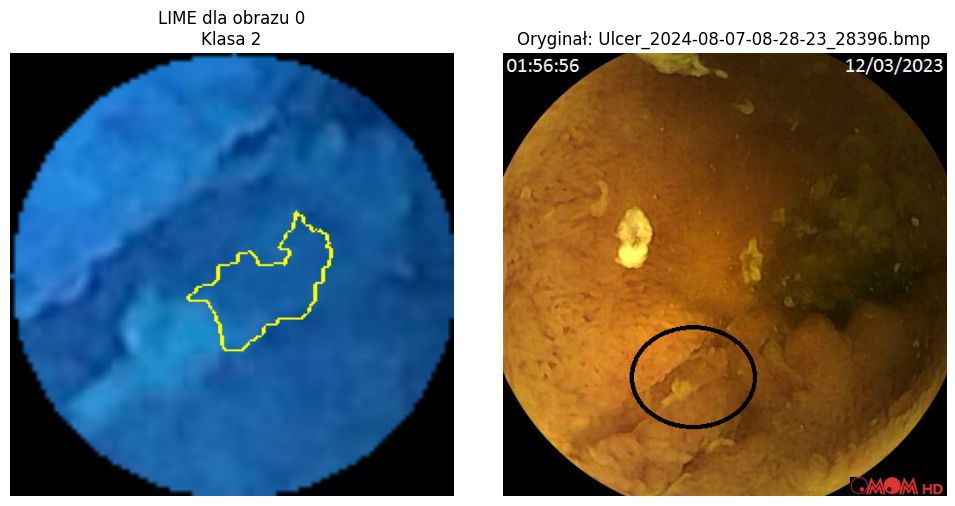

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-28-53_30106.bmp 2


100%|██████████| 1000/1000 [00:45<00:00, 21.91it/s]


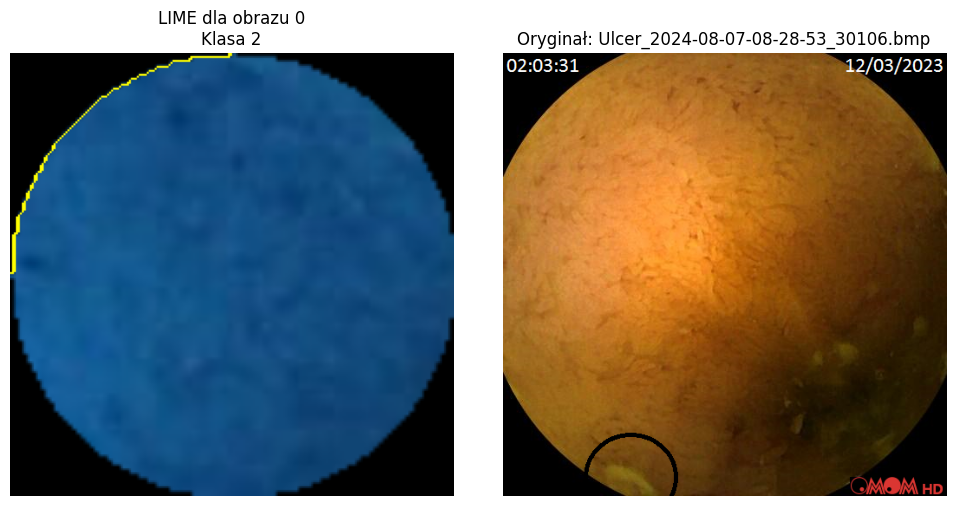

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-29-07_84878.bmp 2


100%|██████████| 1000/1000 [00:44<00:00, 22.32it/s]


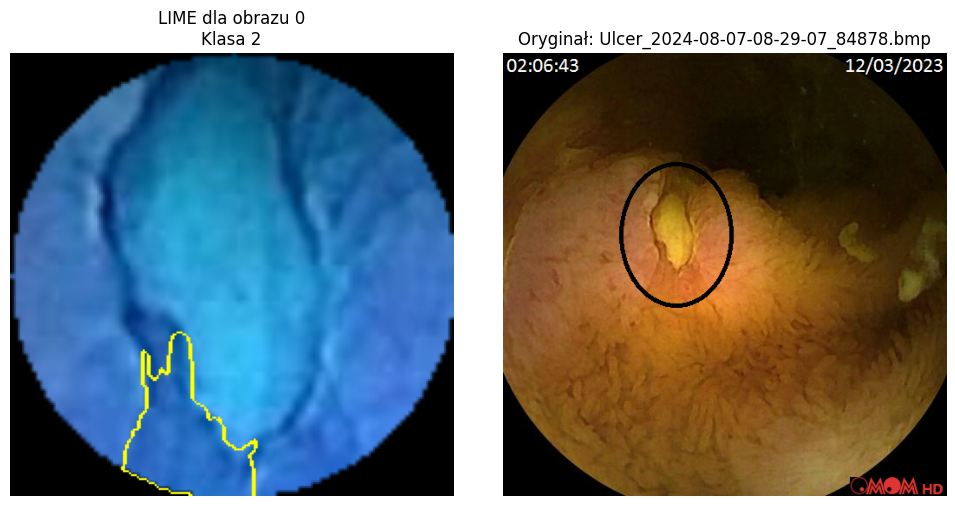

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-29-37_78761.bmp 2


100%|██████████| 1000/1000 [00:44<00:00, 22.28it/s]


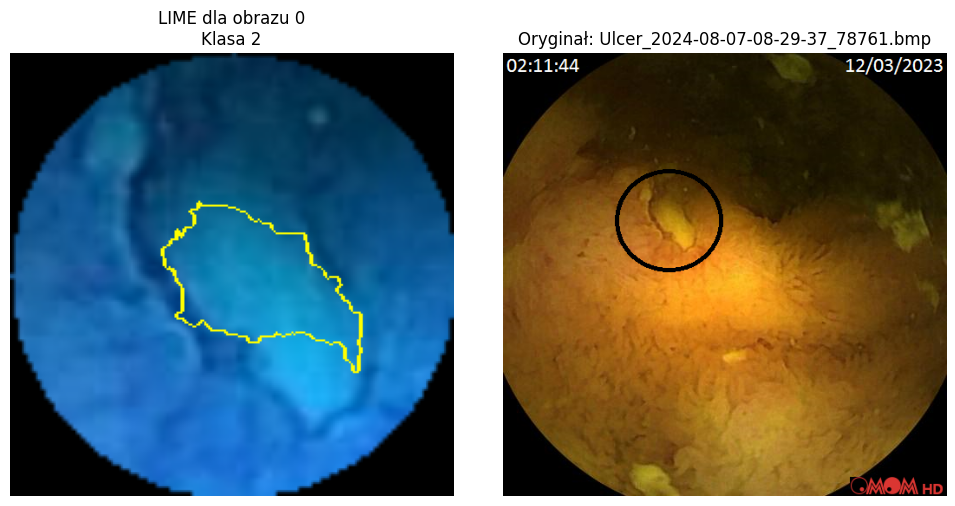

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-30-04_90957.bmp 2


100%|██████████| 1000/1000 [00:44<00:00, 22.25it/s]


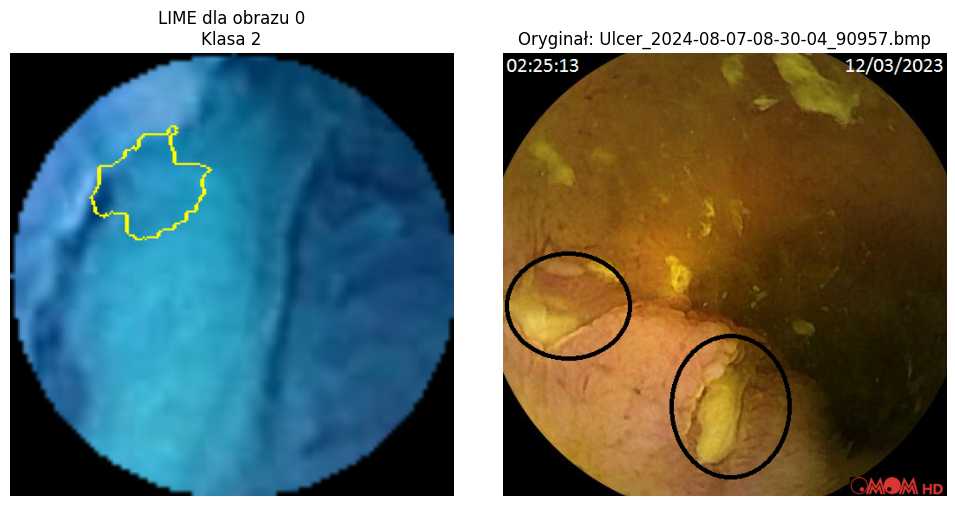

Predykcja: 2, Labels: 2
Ulcer_2024-08-07-08-30-45_21300.bmp 2


100%|██████████| 1000/1000 [00:45<00:00, 21.88it/s]


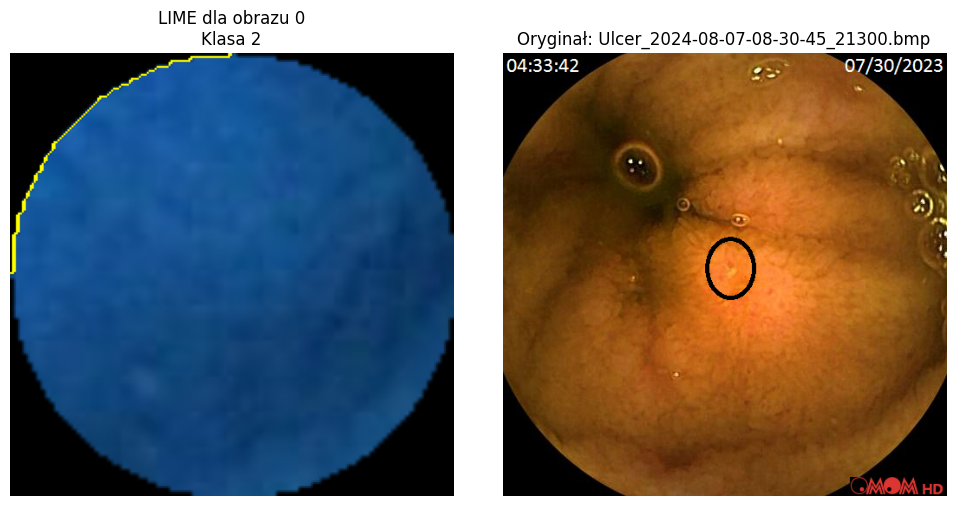

In [160]:
X,y, l = save_to_list("cropped_out_50")
interpret_image(X, y, l,"model_cropped_photos_radius_50.pth", start=50, stop = len(X), step = 50)

Po przejrzeniu wyników lime:
- niewielka część zdjęć rzeczywiście jest identyfikowana po zaznaczonym fragmencie
- niektóre zdjęcia nie zawierają zmiany chorobowej (skutek automatycznego przycinania obrazów - mniejszy promień dawał lepsze wyniki, ale wtedy na zdjęciach dalej pozostawało dużo szumu i model kontynuował naukę na pamięć przykłąd to model model_cropped_photos.pth (z promieniem wycinającym 100))
- dla dużych zmian zajmujących prawie cały obszar wyniki nie są najgorsze, ale losowy obszar też by pokrywał zmianę więc o niczym nie świadczą

 Możliwe, że wybrany sposób klasyfikacji nie prowadzi do dobrego rozwiązania.